In [ ]:
---
title: "Unveiling the Dynamics of Pedestrian Movement in Center City, Philadelphia"
format:
    html:
        code-fold: true
        page-layout: full
jupyter: python3
---

# **Unveiling the Dynamics of Pedestrian Movement in Center City, Philadelphia**
Xiayuanshan Gao

# Overview

In this comprehensive study of pedestrian movement in Center City, Philadelphia, I've dissected walking patterns through a multi-faceted lens to understand the underpinnings of foot traffic dynamics in 2012. Initially, I examined the types of walking trips and the socioeconomic profiles of pedestrians, revealing a preference for walking across a spectrum of income brackets, age groups, and educational levels. Subsequently, I mapped the geography of pedestrian travel, highlighting the central district as the focal point of walking activities, enriched by its transit hubs and amenities. Delving into what attracts people to walk, I uncovered that restaurants, schools, commercial blocks, and green spaces play pivotal roles in drawing pedestrians. Lastly, I employed a regression model to quantify the influence of urban features on pedestrian movement, confirming the importance of amenities like restaurants and public transit in promoting walkability.

# 1. Profiling the Walking Trips and Pedestrians in Philadelphia in 2012

In the first section, I delve into the pedestrian dynamics of Philadelphia in 2012, aiming to unpack the walking trip patterns and profile those who most frequently travel by foot. My exploration spans various dimensions, from the origins and destinations of these journeys to the walkers' socioeconomic characteristics, including income levels, vehicle ownership, gender, age, race, and education. This comprehensive overview not only illuminates the prevalent trends in walking trips but also highlights the diverse tapestry of individuals who opt for pedestrian travel, thereby offering an encompassing snapshot of urban mobility within the city.

In [3]:
import pandas as pd
import numpy as np
import altair as alt
import geopandas as gpd
import hvplot.pandas
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
import datetime
import math
from pandana.loaders import osm
import folium

In [6]:
trip = pd.read_excel('data/4_Trip_Public.xlsx')
trip.head ()

,ID,HH_ID,PERSON_NUM,PERSON_ID,HH_WEIGHT,P_WEIGHT,TOUR_NUM,WKSUB_NUM,WKSUB_ID,TRIP_NUM,...,D_COUNTY,D_CPA,D_MCD,D_TRACT,D_TAZ,GPSFactor,Survey_TravTime,Model_TravTime,Model_TravDist,CompositeWeight
0,1,100140,1,10014001,133.460324,132.54307,1.0,NaN,1.001400e+11,1,...,34007.0,007_802,3.400712e+09,3.400760e+10,22228.0,1.12,15.0,7.456654,1.535654,148.448239
1,2,100140,1,10014001,133.460324,132.54307,1.0,NaN,1.001400e+11,2,...,34007.0,007_802,3.400712e+09,3.400760e+10,22231.0,1.12,7.0,7.810088,1.675524,148.448239
2,3,100140,1,10014001,133.460324,132.54307,1.0,NaN,1.001400e+11,3,...,34005.0,005_702,3.400544e+09,3.400570e+10,20225.0,1.12,12.0,9.363016,2.301180,148.448239
3,4,100140,1,10014001,133.460324,132.54307,1.0,NaN,1.001400e+11,4,...,34005.0,005_702,3.400544e+09,3.400570e+10,20227.0,1.12,16.0,6.233144,1.086251,148.448239
4,5,100140,1,10014001,133.460324,132.54307,1.0,NaN,1.001400e+11,5,...,34005.0,005_702,3.400544e+09,3.400570e+10,20225.0,1.12,10.0,6.258231,1.208349,148.448239


In [8]:
# Trim to Phily and bike trip
walk = trip[(trip['O_COUNTY'] == 42101) & (trip['MODE_AGG'] == 1)]

walk.head()

,ID,HH_ID,PERSON_NUM,PERSON_ID,HH_WEIGHT,P_WEIGHT,TOUR_NUM,WKSUB_NUM,WKSUB_ID,TRIP_NUM,...,D_COUNTY,D_CPA,D_MCD,D_TRACT,D_TAZ,GPSFactor,Survey_TravTime,Model_TravTime,Model_TravDist,CompositeWeight
12,13,100206,1,10020601,204.106167,281.143358,1.0,NaN,1.002060e+11,3,...,42101.0,101_103,4.210160e+09,4.210100e+10,113.0,1.17,15.0,16.783789,0.867162,328.937729
13,14,100206,1,10020601,204.106167,281.143358,1.0,NaN,1.002060e+11,4,...,42101.0,101_103,4.210160e+09,4.210100e+10,44.0,1.17,11.0,12.350352,0.638102,328.937729
302,314,102372,1,10237201,209.139870,218.215946,1.0,NaN,1.023720e+11,4,...,42101.0,101_103,4.210160e+09,4.210100e+10,35.0,1.13,9.0,NaN,NaN,246.584019
303,315,102372,1,10237201,209.139870,218.215946,1.0,NaN,1.023720e+11,5,...,42101.0,101_103,4.210160e+09,4.210100e+10,38.0,1.13,10.0,11.381527,0.588046,246.584019
991,1009,109412,1,10941201,193.156252,82.416676,1.0,NaN,1.094120e+11,3,...,42101.0,101_103,4.210160e+09,4.210100e+10,55.0,1.13,10.0,16.072276,0.830401,93.130844


## 1.1 What Type of Walking Trips Happened in Philadelphia in 2012

From the presented data, it is evident that walking trips in Philadelphia in 2012 were predominantly initiated and concluded at a variety of locations classified under 'Other', denoting a diverse range of non-home and non-work-related starting and ending points. This diversity in trip locations correlates with a higher frequency of walking trips associated with home activities that are not related to work, school, or online engagements. Despite the variety in origins and destinations, there is a notable preference for walking trips that end at 'Home', suggesting that Philadelphia residents may prefer walking for returning home from various activities. In contrast, walking trips starting from 'Work' are less frequent than those ending there, hinting at the possibility that walking is less preferred for commuting to work. The subsequent chart detailing the types of activities associated with walking trips reinforces the inference that non-work-related activities, particularly those centered around the home, are the primary motivators for walking. 

The first pair of charts compare the frequency of different types of locations from where people start and end their walking trips. The categories include 'Other', 'Work', 'Home', and 'School'. For origins, the 'Other' category has the highest count, indicating that most walking trips begin at locations other than work, home, or school. This is followed by 'Work', 'Home', and 'School' which has the least count. For destinations, 'Other' also has the highest count, suggesting that destinations are similarly varied. However, 'Home' has a significantly higher count as a destination than as an origin, while 'Work' has a lower count as a destination than as an origin. 'School' remains the least frequent destination.

C:\Users\gaoxi\AppData\Local\Temp\ipykernel_29064\1475632616.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  walk['O_LOC_TYPE'] = walk['O_LOC_TYPE'].replace(replacement_dict)
C:\Users\gaoxi\AppData\Local\Temp\ipykernel_29064\1475632616.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  walk['D_LOC_TYPE'] = walk['D_LOC_TYPE'].replace(replacement_dict)


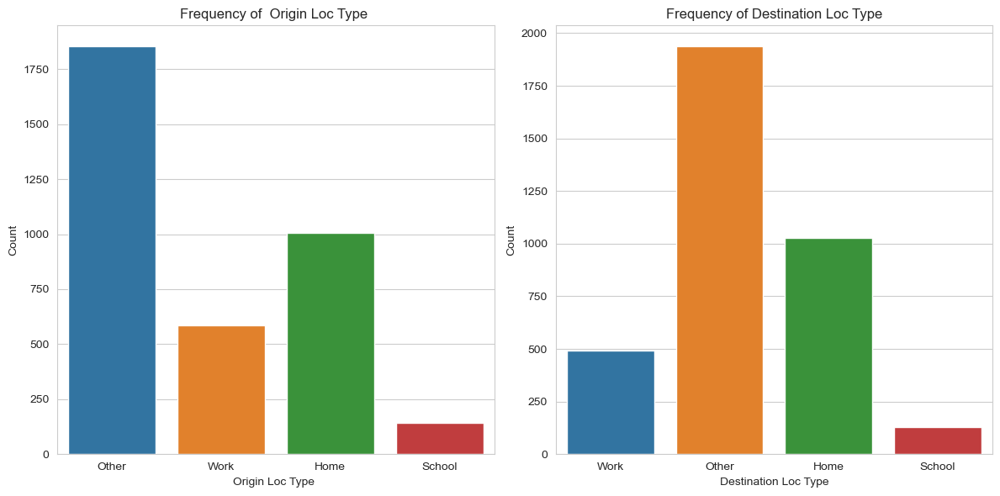

In [9]:
replacement_dict = {1: 'Home', 2: 'Work', 3: 'School', 4: 'Other'}

walk['O_LOC_TYPE'] = walk['O_LOC_TYPE'].replace(replacement_dict)
walk['D_LOC_TYPE'] = walk['D_LOC_TYPE'].replace(replacement_dict)

sns.set_style("whitegrid")

fig, ax = plt.subplots(1, 2, figsize=(12, 6))

# Plot Origin Loc Type 
sns.countplot(x='O_LOC_TYPE', data=walk, ax=ax[0])
ax[0].set_title('Frequency of  Origin Loc Type ')
ax[0].set_xlabel('Origin Loc Type ')
ax[0].set_ylabel('Count')

# Plot Destination Loc Type 
sns.countplot(x='D_LOC_TYPE', data=walk, ax=ax[1])
ax[1].set_title('Frequency of Destination Loc Type')
ax[1].set_xlabel('Destination Loc Type')
ax[1].set_ylabel('Count')

# Show the plot
plt.tight_layout()
plt.show()

The following chart shows the frequency of different types of activities for which walking is used. The most common activity is 'Home activities not related to work, school, or online', indicating that walking is most frequently used for local errands or tasks around the house. This is followed by 'Work for pay' and 'Change type of transportation/transfer'. Activities like 'Social (visit friends, relatives, etc.)', 'Medical (medical appointment, medical procedure, etc.)', and 'Recreation-watch/observe (movies, concert, sports event, etc.)' have lower frequencies.

C:\Users\gaoxi\AppData\Local\Temp\ipykernel_29064\28425172.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  walk['ACTIV1'] = walk['ACTIV1'].replace(activity_dict)


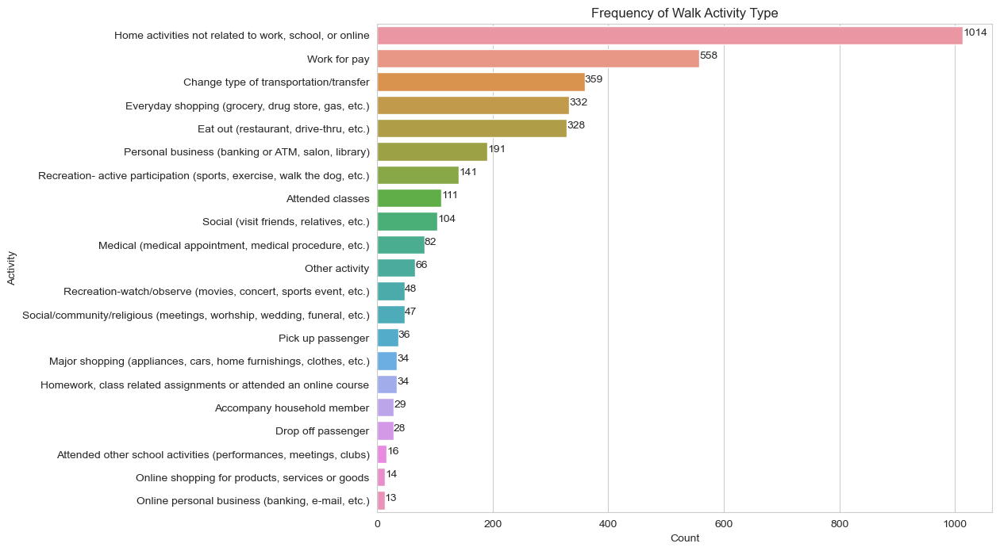

In [10]:
# Find out activity type
activity_dict = { 1: 'Home activities not related to work, school, or online',
                 2: 'Homework, class related assignments or attended an online course',
                 3: 'Attended classes',
                 4: 'Attended other school activities (performances, meetings, clubs)',
                 5: 'Work for pay',
                 6: 'Personal business (banking or ATM, salon, library)',
                 7: 'Online personal business (banking, e-mail, etc.)',
                 8: 'Everyday shopping (grocery, drug store, gas, etc.)',
                 9: 'Major shopping (appliances, cars, home furnishings, clothes, etc.)',
                 10: 'Online shopping for products, services or goods',
                 11: 'Eat out (restaurant, drive-thru, etc.)',
                 12: 'Social (visit friends, relatives, etc.)',
                 13: 'Social/community/religious (meetings, worhship, wedding, funeral, etc.)',
                 14: 'Recreation- active participation (sports, exercise, walk the dog, etc.)',
                 15: 'Recreation-watch/observe (movies, concert, sports event, etc.)',
                 16: 'Medical (medical appointment, medical procedure, etc.)',
                 17: 'Pick up passenger',
                 18: 'Drop off passenger',
                 19: 'Change type of transportation/transfer',
                 20: 'Accompany household member',
                 96: 'Other activity'}

walk['ACTIV1'] = walk['ACTIV1'].replace(activity_dict)

plt.figure(figsize=(10, 8))


activity_counts = walk['ACTIV1'].value_counts()
sns.barplot(y=activity_counts.index, x=activity_counts.values)
plt.title('Frequency of Walk Activity Type')
plt.xlabel('Count')
plt.ylabel('Activity')

for index, value in enumerate(activity_counts.values):
    plt.text(value, index, f'{value}')

plt.show()

## 1.2 Who Prefer to Walk

Then, the following analysis of Philadelphia's pedestrian demographics in 2012 reveals a nuanced portrait influenced by various socioeconomic factors. The data on total vehicles indicates that individuals with no vehicles in their household are the most likely to walk, which is consistent across all income brackets except for the highest and lowest, where walking is less prevalent. Income distribution among pedestrians shows a fairly even spread, with slight peaks in the middle-income ranges, suggesting that walking is not exclusively linked to any single income level.

Gender distribution shows a modest preference for walking among females compared to males. Age-wise, the 25-74 age group is the most inclined to walk, with a notable peak in the 55-59 bracket, highlighting the potential for walking as a consistent transportation choice across a broad adult age spectrum.

Racial demographics indicate that White individuals and those identifying as Asian are more represented among walkers than other races, with Black/African American and Hispanic or Latino individuals walking less by comparison. Education level data shows a clear trend: individuals with higher educational attainment, specifically those with a bachelor's or graduate degree, are more likely to walk than those with lower levels of education or some college credit.

In summary, the typical pedestrian in Philadelphia in 2012 would likely be a person without a vehicle in their household, belonging to the middle-income bracket, and leaning slightly towards the female demographic. Age-wise, adults, particularly those between 25 to 74 years old, with a concentration around late 50s, are the most common walkers. A higher educational background correlates positively with the likelihood of walking, while White and Asian residents tend to walk more than other racial groups. These insights draw a picture of pedestrians in Philadelphia as a diverse group with a significant representation among middle-aged, educated individuals, suggesting that walking is a transportation mode that cuts across various socioeconomic layers, albeit with certain demographic tendencies.

In [11]:
# Load other df
hh = pd.read_excel('data/1_Household_Public.xlsx')

per = pd.read_excel('data/2_Person_Public.xlsx')

import pandas as pd
import matplotlib.pyplot as plt

walk = walk.merge(hh[['HH_ID', 'TOT_VEH', 'INCOME']], on='HH_ID', how='left')
walk = walk.merge(per[['PERSON_ID', 'GEND', 'AGECAT', 'RACE', 'EDUCA']], on='PERSON_ID', how='left')


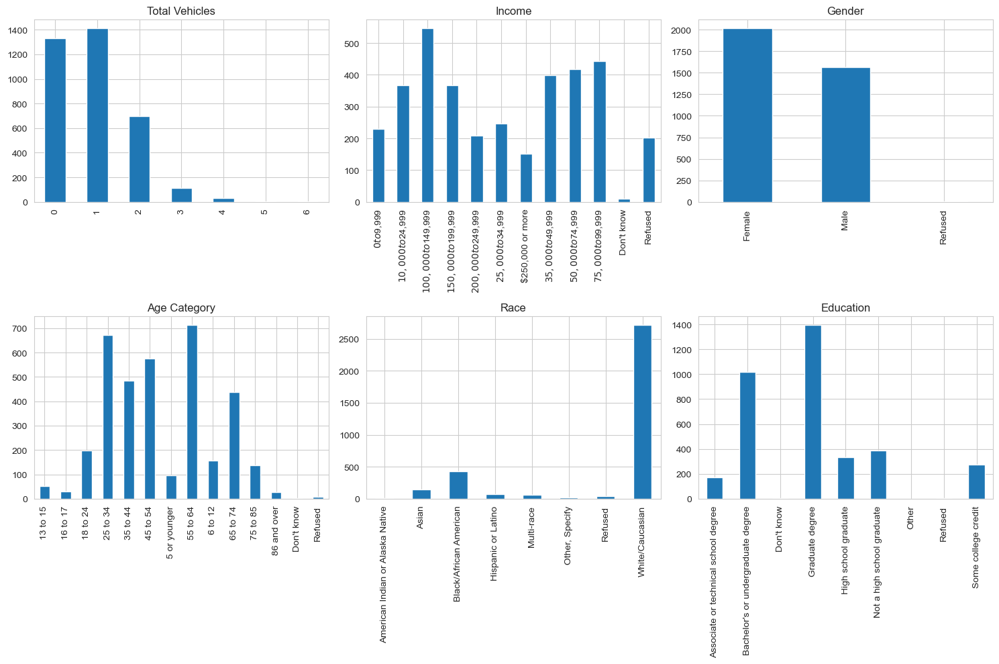

In [12]:
# Create mappings for the variables hh and person 
gend_mapping = {1: 'Male', 2: 'Female', 99: 'Refused'}
agecat_mapping = {
    1: '5 or younger', 2: '6 to 12', 3: '13 to 15', 4: '16 to 17', 
    5: '18 to 24', 6: '25 to 34', 7: '35 to 44', 8: '45 to 54', 
    9: '55 to 64', 10: '65 to 74', 11: '75 to 85', 12: '86 and over',
    98: "Don't know", 99: 'Refused'
}

race_mapping = {
    1: 'White/Caucasian', 2: 'Black/African American', 3: 'Hispanic or Latino',
    4: 'American Indian or Alaska Native', 5: 'Asian', 6: 'Native Hawaiian or Pacific Islander',
    97: 'Other, Specify', 98: "Don't Know", 99: 'Refused', 100: 'Multi-race'
}
educa_mapping = {
    1: 'Not a high school graduate', 2: 'High school graduate', 3: 'Some college credit',
    4: 'Associate or technical school degree', 5: "Bachelor's or undergraduate degree",
    6: 'Graduate degree', 97: 'Other', 98: "Don't know", 99: 'Refused'
}
income_mapping = {
    1: '$0 to $9,999', 2: '$10,000 to $24,999', 3: '$25,000 to $34,999', 4: '$35,000 to $49,999',
    5: '$50,000 to $74,999', 6: '$75,000 to $99,999', 7: '$100,000 to $149,999',
    8: '$150,000 to $199,999', 9: '$200,000 to $249,999', 10: '$250,000 or more',
    98: "Don't know", 99: 'Refused'
}

walk['GEND'] = walk['GEND'].map(gend_mapping)
walk['AGECAT'] = walk['AGECAT'].map(agecat_mapping)
walk['RACE'] = walk['RACE'].map(race_mapping)
walk['EDUCA'] = walk['EDUCA'].map(educa_mapping)
walk['INCOME'] = walk['INCOME'].map(income_mapping)

fig, axs = plt.subplots(2, 3, figsize=(15, 10))  

walk['TOT_VEH'].value_counts().sort_index().plot(kind='bar', ax=axs[0, 0], title='Total Vehicles')
walk['INCOME'].value_counts().sort_index().plot(kind='bar', ax=axs[0, 1], title='Income')
walk['GEND'].value_counts().sort_index().plot(kind='bar', ax=axs[0, 2], title='Gender')
walk['AGECAT'].value_counts().sort_index().plot(kind='bar', ax=axs[1, 0], title='Age Category')
walk['RACE'].value_counts().sort_index().plot(kind='bar', ax=axs[1, 1], title='Race')
walk['EDUCA'].value_counts().sort_index().plot(kind='bar', ax=axs[1, 2], title='Education')

plt.tight_layout()
plt.show()

In conclusion, the multifaceted examination of walking trips in Philadelphia in 2012 reveals that walking is a mode of transportation embraced across a spectrum of socioeconomic backgrounds, with particular tendencies shaped by the absence of vehicles, middle-income brackets, and higher educational attainments. Notably, the proclivity to walk is slightly more common among females and notably prevalent in the 25-74 age demographic, with a surprising peak among those in their late fifties. Additionally, while White and Asian residents are more represented among pedestrians, the data indicates that walking is a universally adopted practice with a presence in every income category and demographic segment. These findings reflect the inherent complexity of pedestrian movement patterns and suggest that walking, as an integral element of urban life, is influenced by a confluence of personal, economic, and cultural factors that define the pedestrian landscape of Philadelphia.

# 2. Where Do People Walk in Philadelphia in 2012

In the second section of my analysis, I turn my focus to the spatial dynamics of pedestrian movement within Philadelphia, unraveling the patterns of where residents choose to walk. Through a series of flow maps and heat maps, I discern the urban fabric's influence on pedestrian behavior. The **central district** emerges as the epicenter of pedestrian activity, with a vibrant flux of walkers traversing its streets, likely due to commercial, cultural, and civic amenities. Adjacent areas such as the lower north, south, University southwest, and west districts also exhibit significant pedestrian traffic, albeit less densely clustered than the central district. In stark contrast, the **lower southwest and lower south districts** present as pedestrian deserts, areas where foot traffic is markedly sparse. These regions may lack pedestrian-friendly infrastructure or destinations that encourage walking. The overlaid heat maps, distinguishing between origins and destinations, further underscore these patterns, revealing hotspots of pedestrian origination and culmination. When combined, these visual tools paint a detailed picture of walking patterns across the city, highlighting areas of high pedestrian engagement and pinpointing zones that could benefit from urban design interventions to enhance walkability and connectivity.

In [13]:
# load Census Tract

import pygris

pa_state_code = '42' 
philly_county_code = '101'

philly_tract = pygris.tracts(state=pa_state_code, county=philly_county_code, year=2012)

philly_tract.head(5)

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
1783,42,101,038100,42101038100,381,Census Tract 381,G5020,S,3335030,1629584,+40.0189334,-075.0399564,"POLYGON ((-75.06785 40.01121, -75.06752 40.011..."
1784,42,101,038400,42101038400,384,Census Tract 384,G5020,S,2546786,0,+40.0714163,-075.2332568,"POLYGON ((-75.24321 40.07356, -75.24313 40.073..."
1785,42,101,038600,42101038600,386,Census Tract 386,G5020,S,3304398,32066,+40.0582762,-075.2110913,"POLYGON ((-75.22199 40.07306, -75.22128 40.073..."
1786,42,101,038500,42101038500,385,Census Tract 385,G5020,S,1338942,2576,+40.0757528,-075.2146234,"POLYGON ((-75.22784 40.08423, -75.22774 40.084..."
1787,42,101,038700,42101038700,387,Census Tract 387,G5020,S,2053212,22241,+40.0833122,-075.2130770,"POLYGON ((-75.22977 40.08676, -75.22961 40.086..."


In [14]:
philly_tract = philly_tract.to_crs(epsg=4326)

# Calculate the centroid points in geographic coordinates
philly_tract['centroid'] = philly_tract.geometry.centroid
philly_tract['centroid_lat'] = philly_tract.centroid.y
philly_tract['centroid_lon'] = philly_tract.centroid.x

philly_tract.head()

C:\Users\gaoxi\AppData\Local\Temp\ipykernel_29064\3754762874.py:4: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  philly_tract['centroid'] = philly_tract.geometry.centroid
C:\Users\gaoxi\AppData\Local\Temp\ipykernel_29064\3754762874.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  philly_tract['centroid_lat'] = philly_tract.centroid.y
C:\Users\gaoxi\AppData\Local\Temp\ipykernel_29064\3754762874.py:6: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  philly_tract['centroid_lon'] = philly_tract.centroid.x


,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,centroid,centroid_lat,centroid_lon
1783,42,101,038100,42101038100,381,Census Tract 381,G5020,S,3335030,1629584,+40.0189334,-075.0399564,"POLYGON ((-75.06785 40.01121, -75.06752 40.011...",POINT (-75.03963 40.01770),40.017698,-75.039634
1784,42,101,038400,42101038400,384,Census Tract 384,G5020,S,2546786,0,+40.0714163,-075.2332568,"POLYGON ((-75.24321 40.07356, -75.24313 40.073...",POINT (-75.23326 40.07142),40.071418,-75.233255
1785,42,101,038600,42101038600,386,Census Tract 386,G5020,S,3304398,32066,+40.0582762,-075.2110913,"POLYGON ((-75.22199 40.07306, -75.22128 40.073...",POINT (-75.21027 40.05805),40.058053,-75.210272
1786,42,101,038500,42101038500,385,Census Tract 385,G5020,S,1338942,2576,+40.0757528,-075.2146234,"POLYGON ((-75.22784 40.08423, -75.22773 40.084...",POINT (-75.21369 40.07591),40.075907,-75.213688
1787,42,101,038700,42101038700,387,Census Tract 387,G5020,S,2053212,22241,+40.0833122,-075.2130770,"POLYGON ((-75.22977 40.08676, -75.22961 40.086...",POINT (-75.21434 40.08330),40.083299,-75.214342


In [15]:
philly_tract['TRACTCE'] = philly_tract['TRACTCE'].astype(str)

walk['O_TRACT'] = walk['O_TRACT'].astype(str)
walk['D_TRACT'] = walk['D_TRACT'].astype(str)

# only keep the strings for tract
walk['O_TRACT'] = walk['O_TRACT'].str[5:11]
walk['D_TRACT'] = walk['D_TRACT'].str[5:11]

walk.head()

,ID,HH_ID,PERSON_NUM,PERSON_ID,HH_WEIGHT,P_WEIGHT,TOUR_NUM,WKSUB_NUM,WKSUB_ID,TRIP_NUM,...,Survey_TravTime,Model_TravTime,Model_TravDist,CompositeWeight,TOT_VEH,INCOME,GEND,AGECAT,RACE,EDUCA
0,13,100206,1,10020601,204.106167,281.143358,1.0,NaN,1.002060e+11,3,...,15.0,16.783789,0.867162,328.937729,2,"$50,000 to $74,999",Male,45 to 54,NaN,Bachelor's or undergraduate degree
1,14,100206,1,10020601,204.106167,281.143358,1.0,NaN,1.002060e+11,4,...,11.0,12.350352,0.638102,328.937729,2,"$50,000 to $74,999",Male,45 to 54,NaN,Bachelor's or undergraduate degree
2,314,102372,1,10237201,209.139870,218.215946,1.0,NaN,1.023720e+11,4,...,9.0,NaN,NaN,246.584019,2,Refused,Male,35 to 44,NaN,Graduate degree
3,315,102372,1,10237201,209.139870,218.215946,1.0,NaN,1.023720e+11,5,...,10.0,11.381527,0.588046,246.584019,2,Refused,Male,35 to 44,NaN,Graduate degree
4,1009,109412,1,10941201,193.156252,82.416676,1.0,NaN,1.094120e+11,3,...,10.0,16.072276,0.830401,93.130844,2,Refused,Female,65 to 74,NaN,Graduate degree


In [16]:

# Merge latitude and longitude for origins
walk = walk.merge(
    philly_tract[['TRACTCE', 'centroid_lat', 'centroid_lon']].rename(
        columns={'centroid_lat': 'origin_lat', 'centroid_lon': 'origin_lon','TRACTCE': 'origin_tra'}
    ),
    how='left', left_on='O_TRACT', right_on='origin_tra'
)

# Merge latitude and longitude for destinations
walk = walk.merge(
    philly_tract[['TRACTCE', 'centroid_lat', 'centroid_lon']].rename(
        columns={'centroid_lat': 'destination_lat', 'centroid_lon': 'destination_lon','TRACTCE': 'destination_tra'}
    ),
    how='left', left_on='D_TRACT', right_on='destination_tra'
)


walk.head()

,ID,HH_ID,PERSON_NUM,PERSON_ID,HH_WEIGHT,P_WEIGHT,TOUR_NUM,WKSUB_NUM,WKSUB_ID,TRIP_NUM,...,GEND,AGECAT,RACE,EDUCA,origin_tra,origin_lat,origin_lon,destination_tra,destination_lat,destination_lon
0,13,100206,1,10020601,204.106167,281.143358,1.0,NaN,1.002060e+11,3,...,Male,45 to 54,NaN,Bachelor's or undergraduate degree,000804,39.948566,-75.167755,000300,39.957150,-75.171232
1,14,100206,1,10020601,204.106167,281.143358,1.0,NaN,1.002060e+11,4,...,Male,45 to 54,NaN,Bachelor's or undergraduate degree,000300,39.957150,-75.171232,000804,39.948566,-75.167755
2,314,102372,1,10237201,209.139870,218.215946,1.0,NaN,1.023720e+11,4,...,Male,35 to 44,NaN,Graduate degree,001002,39.945006,-75.146618,001002,39.945006,-75.146618
3,315,102372,1,10237201,209.139870,218.215946,1.0,NaN,1.023720e+11,5,...,Male,35 to 44,NaN,Graduate degree,001002,39.945006,-75.146618,000902,39.947161,-75.156637
4,1009,109412,1,10941201,193.156252,82.416676,1.0,NaN,1.094120e+11,3,...,Female,65 to 74,NaN,Graduate degree,000500,39.951955,-75.158176,000600,39.949386,-75.158334


In [102]:
import folium

average_lat = walk[['origin_lat', 'destination_lat']].stack().mean()
average_lon = walk[['origin_lon', 'destination_lon']].stack().mean()

od = folium.Map(location=[average_lat, average_lon], zoom_start=12,
    tiles='CartoDB positron')

for idx, row in walk.iterrows():
    if pd.notnull(row['origin_lat']) and pd.notnull(row['origin_lon']):
        folium.CircleMarker(
            location=[row['origin_lat'], row['origin_lon']],
            radius=3,
            color='skyblue',
            fill=True,
            fill_color='skyblue'
        ).add_to(od)

    if pd.notnull(row['destination_lat']) and pd.notnull(row['destination_lon']):
        folium.CircleMarker(
            location=[row['destination_lat'], row['destination_lon']],
            radius=3,
            color='pink',
            fill=True,
            fill_color='pink'
        ).add_to(od)
    
    if pd.notnull(row['origin_lat']) and pd.notnull(row['origin_lon']) and \
       pd.notnull(row['destination_lat']) and pd.notnull(row['destination_lon']):
        folium.PolyLine(
            locations=[
                [row['origin_lat'], row['origin_lon']],
                [row['destination_lat'], row['destination_lon']]
            ],
            color='lavender',
            weight=1
        ).add_to(od)

od

In [19]:
# Load the district boundaries file
districts_gdf = gpd.read_file('data/Planning_Districts.geojson')

districts_gdf = districts_gdf.to_crs(epsg=4326)

In [104]:
# plot the heatmap with origin
from folium.plugins import HeatMap

heatmap_data = walk[['origin_lat', 'origin_lon']].dropna().values.tolist()

o_des = folium.Map(location=[average_lat, average_lon], zoom_start=12, tiles='CartoDB positron')

HeatMap(heatmap_data).add_to(o_des)

for _, row in districts_gdf.iterrows():
    sim_geo = gpd.GeoSeries(row['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'transparent', 'color': 'black'})
    geo_j.add_to(o_des)

o_des


In [105]:
# plot the heatmap with origin
from folium.plugins import HeatMap

heatmap_data2 = walk[['destination_lat', 'destination_lon']].dropna().values.tolist()

d_des = folium.Map(location=[average_lat, average_lon], zoom_start=12, tiles='CartoDB positron')

HeatMap(heatmap_data2).add_to(d_des)

for _, row in districts_gdf.iterrows():
    sim_geo = gpd.GeoSeries(row['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'transparent', 'color': 'black'})
    geo_j.add_to(d_des)

d_des

In [109]:
from folium.plugins import HeatMap

# Assuming walk['origin_lat'] and walk['origin_lon'] are the coordinates for origins
heatmap_data_origins = walk[['origin_lat', 'origin_lon']].dropna().values.tolist()

# Assuming walk['destination_lat'] and walk['destination_lon'] are the coordinates for destinations
heatmap_data_destinations = walk[['destination_lat', 'destination_lon']].dropna().values.tolist()

# Create a Folium map centered around the average coordinates
heat_combined = folium.Map(location=[average_lat, average_lon], zoom_start=12, tiles='CartoDB positron')

# Add the origin heatmap layer with one color gradient
HeatMap(heatmap_data_origins, radius=7, blur=15, gradient={0.2: 'blue', 0.4: 'cyan', 0.6: 'lime', 0.8: 'yellow'}).add_to(heat_combined)

# Add the destination heatmap layer with another color gradient
HeatMap(heatmap_data_destinations, radius=7, blur=15, gradient={0.2: 'purple', 0.4: 'violet', 0.6: 'magenta', 0.8: 'pink'}).add_to(heat_combined)

# Overlay the district boundaries
for _, row in districts_gdf.iterrows():
    sim_geo = gpd.GeoSeries(row['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'transparent', 'color': 'black', 'weight': 1})
    geo_j.add_to(heat_combined)
    

heat_combined


# 3. Explore Center City as the Pedestrain Busy District

## 3.1 Why and Who Walk in Center City

After uncovering the pedestrain busy district of center city, here in this section, I specifically examined the walk trips and pedestrains in center city. 

In my exploration of pedestrian activities within Philadelphia's central district, I identified distinctive patterns of movement. **The data indicated a high frequency of 'transfer' activities, which suggests that the central district serves not only as a destination but also as a pivotal hub for pedestrian movement through the city.** This is reflective of the dense network of public transit and the district's role as a connector for various parts of the city. Among other prominent activities, 'work for pay' and 'eat out (restaurant, drive-thru, etc.)' were also significant, highlighting the central district's commercial and social importance. Surprisingly, 'home activities' were the most frequent type of walk, which may be attributed to the residential pockets within the central district or the tendency of individuals to categorize errands close to home as 'home activities'.

In [20]:
import geopandas as gpd
from shapely.geometry import Point

# filter out the walk trip in the central district

walk_gdf = gpd.GeoDataFrame(walk, geometry=gpd.points_from_xy(walk.origin_lon, walk.origin_lat))

walk_gdf.crs = districts_gdf.crs

central_polygon = districts_gdf.loc[districts_gdf['DIST_NAME'] == 'Central', 'geometry'].squeeze()

walk_in_central = walk_gdf[walk_gdf.geometry.within(central_polygon)]

walk_in_central.head()

,ID,HH_ID,PERSON_NUM,PERSON_ID,HH_WEIGHT,P_WEIGHT,TOUR_NUM,WKSUB_NUM,WKSUB_ID,TRIP_NUM,...,AGECAT,RACE,EDUCA,origin_tra,origin_lat,origin_lon,destination_tra,destination_lat,destination_lon,geometry
0,13,100206,1,10020601,204.106167,281.143358,1.0,NaN,1.002060e+11,3,...,45 to 54,NaN,Bachelor's or undergraduate degree,000804,39.948566,-75.167755,000300,39.957150,-75.171232,POINT (-75.16775 39.94857)
1,14,100206,1,10020601,204.106167,281.143358,1.0,NaN,1.002060e+11,4,...,45 to 54,NaN,Bachelor's or undergraduate degree,000300,39.957150,-75.171232,000804,39.948566,-75.167755,POINT (-75.17123 39.95715)
2,314,102372,1,10237201,209.139870,218.215946,1.0,NaN,1.023720e+11,4,...,35 to 44,NaN,Graduate degree,001002,39.945006,-75.146618,001002,39.945006,-75.146618,POINT (-75.14662 39.94501)
3,315,102372,1,10237201,209.139870,218.215946,1.0,NaN,1.023720e+11,5,...,35 to 44,NaN,Graduate degree,001002,39.945006,-75.146618,000902,39.947161,-75.156637,POINT (-75.14662 39.94501)
4,1009,109412,1,10941201,193.156252,82.416676,1.0,NaN,1.094120e+11,3,...,65 to 74,NaN,Graduate degree,000500,39.951955,-75.158176,000600,39.949386,-75.158334,POINT (-75.15818 39.95195)


D:\Anaconda\Install\envs\musa-550-fall-2023\lib\site-packages\geopandas\geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


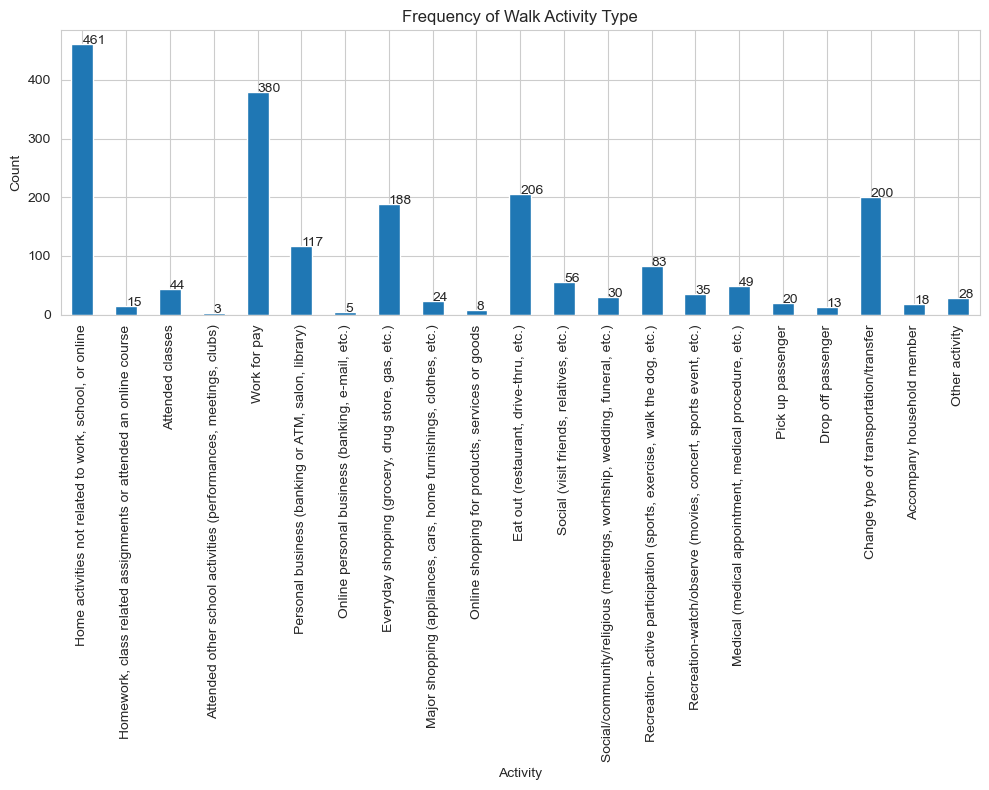

In [192]:
activity_mapping = { 1: 'Home activities not related to work, school, or online',
                 2: 'Homework, class related assignments or attended an online course',
                 3: 'Attended classes',
                 4: 'Attended other school activities (performances, meetings, clubs)',
                 5: 'Work for pay',
                 6: 'Personal business (banking or ATM, salon, library)',
                 7: 'Online personal business (banking, e-mail, etc.)',
                 8: 'Everyday shopping (grocery, drug store, gas, etc.)',
                 9: 'Major shopping (appliances, cars, home furnishings, clothes, etc.)',
                 10: 'Online shopping for products, services or goods',
                 11: 'Eat out (restaurant, drive-thru, etc.)',
                 12: 'Social (visit friends, relatives, etc.)',
                 13: 'Social/community/religious (meetings, worhship, wedding, funeral, etc.)',
                 14: 'Recreation- active participation (sports, exercise, walk the dog, etc.)',
                 15: 'Recreation-watch/observe (movies, concert, sports event, etc.)',
                 16: 'Medical (medical appointment, medical procedure, etc.)',
                 17: 'Pick up passenger',
                 18: 'Drop off passenger',
                 19: 'Change type of transportation/transfer',
                 20: 'Accompany household member',
                 96: 'Other activity'}

walk_in_central['ACTIV1'] = walk_in_central['ACTIV1'].map(activity_mapping)

# Plotting
plt.figure(figsize=(10, 8)) 
activity_counts = walk_in_central['ACTIV1'].value_counts()


ordered_activities = activity_counts.reindex(activity_mapping.values())


ordered_activities.plot(kind='bar')

plt.title('Frequency of Walk Activity Type')
plt.xlabel('Activity')
plt.ylabel('Count')


plt.xticks(rotation=90) 


for index, value in enumerate(ordered_activities.values):
    plt.text(index, value, f'{value}') 

plt.tight_layout() 
plt.show()

Upon reprofiling the pedestrian demographic within the central district, I found that the socioeconomic characteristics closely mirrored those observed citywide. Vehicle ownership, income, age, race, gender, and education level demonstrated similar trends, with no significant deviations. This lack of disparity suggests a consistent pedestrian demographic across the city, irrespective of the more intense walking activity in the central district. Most walkers belonged to households without a vehicle, spanned across a diverse range of income levels, and were predominantly White/Caucasian with at least a graduate degree, reflecting the broader city's pedestrian profile. However, it was interesting to note that the central district's pedestrian population was just as diverse as the rest of Philadelphia, reinforcing the notion that walking as a mode of transport transcends socioeconomic boundaries within urban centers.

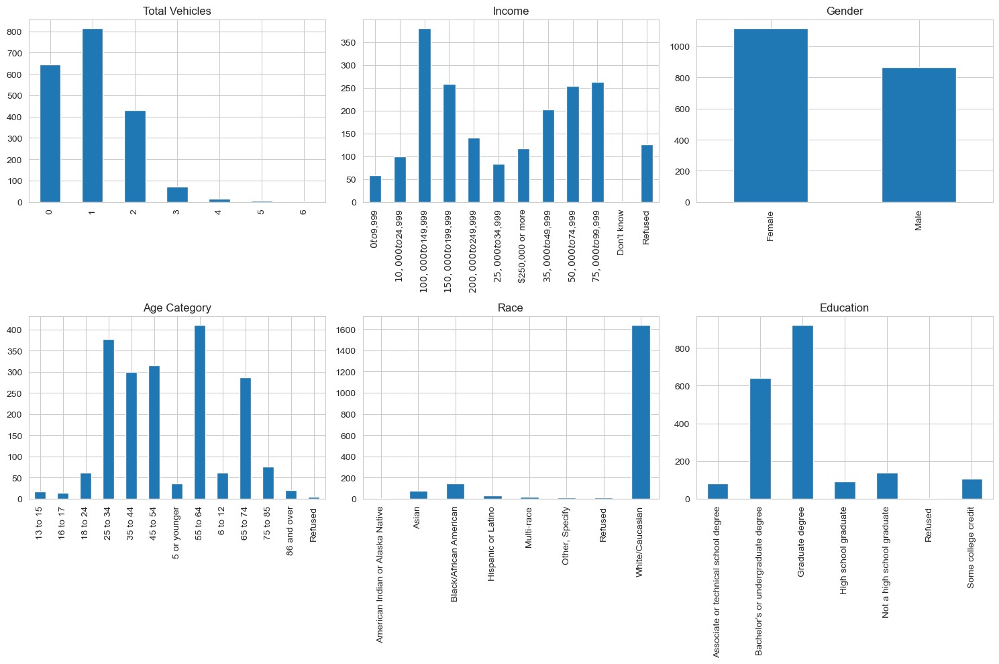

In [258]:
fig, axs = plt.subplots(2, 3, figsize=(15, 10))  

walk_in_central['TOT_VEH'].value_counts().sort_index().plot(kind='bar', ax=axs[0, 0], title='Total Vehicles')
walk_in_central['INCOME'].value_counts().sort_index().plot(kind='bar', ax=axs[0, 1], title='Income')
walk_in_central['GEND'].value_counts().sort_index().plot(kind='bar', ax=axs[0, 2], title='Gender')
walk_in_central['AGECAT'].value_counts().sort_index().plot(kind='bar', ax=axs[1, 0], title='Age Category')
walk_in_central['RACE'].value_counts().sort_index().plot(kind='bar', ax=axs[1, 1], title='Race')
walk_in_central['EDUCA'].value_counts().sort_index().plot(kind='bar', ax=axs[1, 2], title='Education')

plt.tight_layout()
plt.show()

## 3.2 What are There in Center City Attracting People to Walk Here

In the latter half of my analysis of Center City, I delved into the urban elements that contribute to its high pedestrian traffic. I used OpenStreetMap to overlay various components of the urban environment, revealing a dense and intricate web of walkways that form the backbone of pedestrian movement in the area. My mapping highlighted an extensive network of roads frequented by pedestrians, which are well-serviced by an array of public transit options, including numerous bus stops and metro stations strategically located throughout the district.

The presence of these amenities suggests a cityscape thoughtfully designed to encourage walking, where the convenience of public transport complements pedestrian pathways. Moreover, my data visualizations pinpointed clusters of restaurants, schools, and commercial blocks, which serve as vital nodes of activity, drawing people onto the streets. These commercial hubs are not only destinations but also waypoints that enliven the pedestrian experience with their vibrancy and accessibility.

In [47]:
import osmnx as ox
ox.config(use_cache=True, log_console=True)

# For bus stops
bus_stops = ox.geometries_from_place('Center City,Philadelphia, PA', tags={'highway': 'bus_stop'})

# For metro stops 
metro_stops = ox.geometries_from_place('Center City,Philadelphia, PA', tags={'railway': 'station'})

# For restaurants
restaurants = ox.geometries_from_place('Center City,Philadelphia, PA', tags={"amenity": ["pub", "bar", "restaurant"]})

# For schools
schools = ox.geometries_from_place('Center City,Philadelphia, PA', tags={'amenity': 'school'})

# For commercial blocks
commercial = ox.geometries_from_place('Center City,Philadelphia, PA', tags={'landuse': 'commercial'})

# For parks
parks = ox.geometries_from_place('Center City,Philadelphia, PA', tags={'leisure': 'park'})


C:\Users\gaoxi\AppData\Local\Temp\ipykernel_29064\2733245946.py:2: UserWarning: The `utils.config` function is deprecated and will be removed in a future release. Instead, use the `settings` module directly to configure a global setting's value. For example, `ox.settings.log_console=True`.
  ox.config(use_cache=True, log_console=True)
C:\Users\gaoxi\AppData\Local\Temp\ipykernel_29064\2733245946.py:5: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.
  bus_stops = ox.geometries_from_place('Center City,Philadelphia, PA', tags={'highway': 'bus_stop'})
C:\Users\gaoxi\AppData\Local\Temp\ipykernel_29064\2733245946.py:8: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The

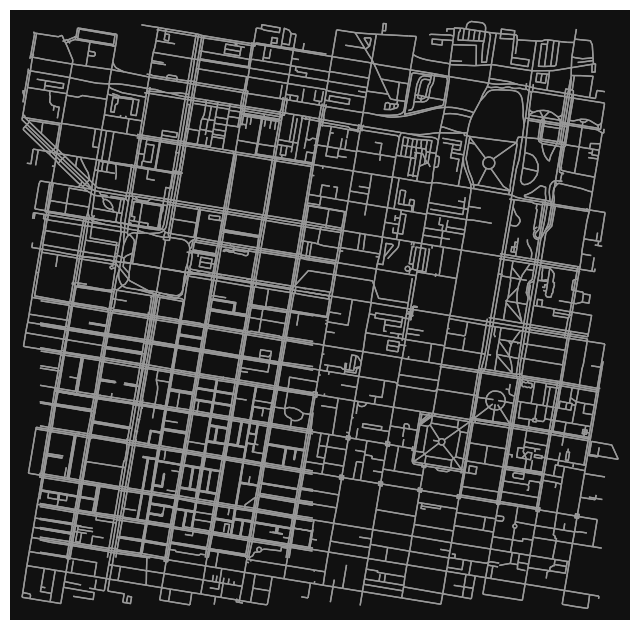

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [201]:
# the "walk" network
G = ox.graph_from_address("Center City, Philadelphia, PA", network_type="walk")
ox.plot_graph(ox.project_graph(G), node_size=0)

In [214]:

G_cc = ox.graph_from_polygon(central_polygon, network_type="walk")

# only get the edges
cc_edges = ox.graph_to_gdfs(G_cc, edges=True, nodes=False)

# add the neighborhood boundaries
boundary = gpd.GeoSeries([central_polygon], crs="EPSG:4326")

cc_edges.explore(tiles='cartodb positron')

In [22]:
import geopandas as gpd

centroid = central_polygon.centroid
central_point = centroid

longitude = central_point.x
latitude = central_point.y

In [224]:
import folium

bus = folium.Map(location=[latitude, longitude], zoom_start=13)

for idx, row in bus_stops.iterrows():
    folium.Marker(location=[row.geometry.y, row.geometry.x], popup='Bus Stop').add_to(bus)

bus

In [225]:
metro = folium.Map(location=[latitude, longitude], zoom_start=13)

for idx, row in metro_stops.iterrows():
    folium.Marker(location=[row.geometry.y, row.geometry.x], popup='Metro Stops').add_to(metro)

metro

In [54]:
restaurant_points = restaurants[restaurants.geometry.type == 'Point']

map_center = restaurant_points.geometry.unary_union.centroid

res_m = folium.Map(location=[map_center.y, map_center.x], zoom_start=14)

for idx, row in restaurant_points.iterrows():
    folium.Marker(
        location=[row.geometry.y, row.geometry.x], 
        popup='Restaurant'
    ).add_to(res_m)

res_m

In [57]:
schools_points = schools[schools.geometry.type == 'Point']

map_center = schools_points.geometry.unary_union.centroid

schools_map = folium.Map(location=[map_center.y, map_center.x], zoom_start=14)

for idx, row in schools_points.iterrows():
    marker = folium.Marker(location=[row.geometry.y, row.geometry.x], popup='Schools')
    marker.add_to(schools_map)

schools_map

In [63]:
from shapely.geometry import Polygon, MultiPolygon
commerce_m = folium.Map(location=[latitude, longitude], zoom_start=13)

for idx, row in commercial.iterrows():
    if isinstance(row.geometry, (Polygon, MultiPolygon)):
        folium.GeoJson(row.geometry, 
                        popup='Commercial Block',
                        style_function=lambda x: {'fillColor': 'blue', 'color': 'blue'}
                       ).add_to(commerce_m)

commerce_m

In addition to these urban features, the green spaces represented by parks emerged as significant attractors for walkers, offering respite and recreational space amidst the urban fabric. These verdant areas likely contribute to the appeal of walking by enhancing the environmental quality and aesthetic of the city.

In [64]:
parks_map = folium.Map(location=[latitude, longitude], zoom_start=13)

for idx, park in parks.iterrows():
    if isinstance(park.geometry, (Polygon, MultiPolygon)):
        folium.GeoJson(
            data=park.geometry.__geo_interface__,
            popup='Park',
            style_function=lambda x: {'fillColor': 'green', 'color': 'green'}
        ).add_to(parks_map)

parks_map

Overall, my investigation paints a picture of Center City as a robust hub of pedestrian activity, supported by a well-integrated system of walkways, transit stops, commercial establishments, educational institutions, and green spaces. Each element plays a role in creating an inviting pedestrian environment, showcasing the multifaceted allure of Center City for walkers. The harmonious interplay between these factors not only facilitates but also enriches the pedestrian experience, affirming Center City's reputation as a vibrant and walkable urban center.

# 4. Why Center City Become a Pedestrain Busy Zone

To further understand what drives pedestrian movement in Center City, I conducted a regression analysis with the aim of quantifying the influence of various urban features on walking trip counts. Using Python's scikit-learn library, I fitted a linear regression model with variables including the count of bus stops, metro stops, restaurants, schools, commercial areas, and park areas.

In [240]:
import geopandas as gpd
from shapely.geometry import Point
from sklearn.linear_model import LinearRegression
import pandas as pd

In [65]:
districts_gdf.head()
central = districts_gdf.loc[districts_gdf['DIST_NAME'] == 'Central', 'geometry']

In [66]:
philly_tract.set_crs(epsg=4326, inplace=True)

central_gdf = gpd.GeoDataFrame(central)

central_gdf.set_crs(philly_tract.crs, inplace=True)

central_tracts = gpd.sjoin(philly_tract, central_gdf, how="inner", op='intersects')

D:\Anaconda\Install\envs\musa-550-fall-2023\lib\site-packages\IPython\core\interactiveshell.py:3448: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


In [83]:
if 'index_right' in central_tracts.columns:
    central_tracts = central_tracts.drop(columns=['index_right'])

In [87]:
import geopandas as gpd

def count_pois(geo_df, tracts_df, poi_name):
    join = gpd.sjoin(geo_df, tracts_df, predicate='within')
    count = join.groupby('index_right').size()
    tracts_df[poi_name] = count.reindex(tracts_df.index, fill_value=0)

def calculate_area(geo_df, tracts_df, area_name):
    join = gpd.sjoin(geo_df, tracts_df, predicate='intersects')
    area = join.groupby('index_right').apply(lambda g: g.geometry.area.sum())
    tracts_df[area_name] = area.reindex(tracts_df.index, fill_value=0)

count_pois(bus_stops, central_tracts, 'bus_stop_count')
count_pois(metro_stops, central_tracts, 'metro_stop_count')
count_pois(restaurant_points, central_tracts, 'restaurant_count')
count_pois(schools_points, central_tracts, 'school_count')
count_pois(walk_in_central, central_tracts, 'walktrip_count')


calculate_area(commercial, central_tracts, 'commercial_area')
calculate_area(parks, central_tracts, 'park_area')

central_tracts.reset_index(drop=True, inplace=True)


C:\Users\gaoxi\AppData\Local\Temp\ipykernel_29064\1808947791.py:10: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  area = join.groupby('index_right').apply(lambda g: g.geometry.area.sum())
C:\Users\gaoxi\AppData\Local\Temp\ipykernel_29064\1808947791.py:10: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  area = join.groupby('index_right').apply(lambda g: g.geometry.area.sum())


In [88]:
central_tracts.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,centroid,centroid_lat,centroid_lon,metro_stop_count,restaurant_count,school_count,commercial_area,park_area,bus_stop_count,walktrip_count
0,42,101,980000,42101980000,9800,Census Tract 9800,G5020,S,8923895,1501892,...,POINT (-75.20022 39.98506),39.985064,-75.200217,0,0,0,0.000000e+00,0.000310,1,0
1,42,101,036700,42101036700,367,Census Tract 367,G5020,S,801972,0,...,POINT (-75.14399 39.96073),39.960726,-75.143987,1,2,0,1.814250e-06,0.000003,0,18
2,42,101,037600,42101037600,376,Census Tract 376,G5020,S,717301,0,...,POINT (-75.15516 39.95990),39.959902,-75.155163,0,4,4,2.725569e-07,0.000001,0,7
3,42,101,036900,42101036900,369,Census Tract 369,G5020,S,1859160,193283,...,POINT (-75.19370 39.94910),39.949097,-75.193703,0,0,0,0.000000e+00,0.000000,0,0
4,42,101,036600,42101036600,366,Census Tract 366,G5020,S,1004315,1426276,...,POINT (-75.13895 39.94486),39.944863,-75.138949,0,3,0,0.000000e+00,0.000008,1,16


The correlation heatmap provided initial insights into the relationships between these variables, showing a strong positive correlation between the number of restaurants and walking trips, which aligns with the idea that dining options significantly contribute to pedestrian traffic. A moderate positive correlation was also observed between the number of bus and metro stops and walking trips, supporting the notion that public transit accessibility encourages walking.

<Axes: >

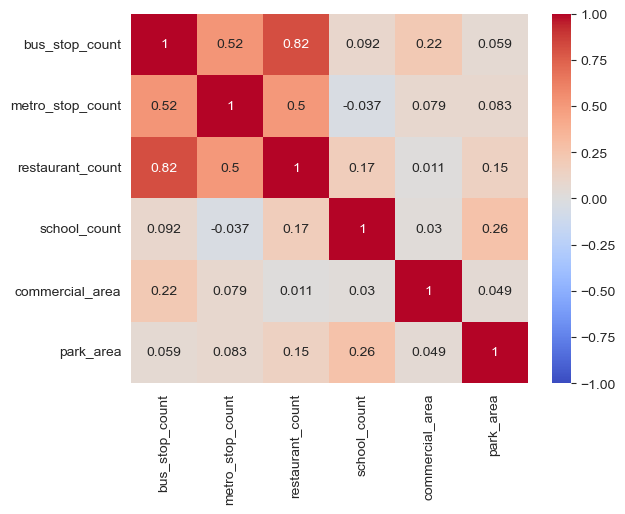

In [101]:
train_set = central_tracts[['bus_stop_count', 'metro_stop_count', 'restaurant_count', 'school_count', 'commercial_area', 'park_area']]

sns.heatmap(
    train_set.corr(),
    cmap="coolwarm",
    annot=True,
    vmin=-1,
    vmax=1
)

In [102]:
from sklearn.linear_model import LinearRegression

X = central_tracts[['metro_stop_count', 'restaurant_count', 'school_count', 'commercial_area', 'park_area']]
y = central_tracts['walktrip_count']  

model = LinearRegression()
model.fit(X, y)

LinearRegression()

Upon fitting the linear regression model, the coefficients revealed the relative impact of each feature. The presence of restaurants had a noticeable positive coefficient, suggesting a strong relationship with pedestrian activity. Interestingly, the number of schools had a negative coefficient, which could indicate that the areas around schools in Center City do not necessarily generate additional foot traffic, or other factors may be at play that weren't captured in the model.

The model's mean squared error (MSE) and coefficient of determination (R²) were evaluated to measure its performance. With an R² value of approximately 0.426, the model explains around 42.6% of the variance in walking trips. While this indicates that the model has captured a significant portion of the factors affecting pedestrian movement, there is still a substantial amount of variance unexplained, which could be due to unmodeled variables or the complexity of pedestrian dynamics that are not easily captured by linear relationships.

In [90]:
print(f'Coefficients: {model.coef_}')
print(f'Intercept: {model.intercept_}')

Coefficients: [ 9.72257383e+00  2.25749357e+01 -1.44216056e+00  1.83764737e+00
 -8.41207906e+05  1.29592761e+04]
Intercept: 20.57387711612844


In [103]:
from sklearn.metrics import mean_squared_error, r2_score

y_pred = model.predict(X)

print(f'Mean squared error (MSE): {mean_squared_error(y, y_pred)}')
print(f'Coefficient of determination (R^2): {r2_score(y, y_pred)}')

Mean squared error (MSE): 1977.6339251018762
Coefficient of determination (R^2): 0.42607554891522836


In conclusion, my regression analysis has shed light on some key factors that appear to influence walking trip counts in Center City. While the findings confirm the importance of amenities like restaurants and public transit stops, they also prompt further investigation into other potential influences on pedestrian activity. This model serves as a foundational step towards a more nuanced understanding of urban walkability and the myriad elements that foster an inviting pedestrian environment.

# 5. Conclusion & Next Step

The findings from this project underscore the intricate relationship between urban design and pedestrian behavior. Center City's robust network of walkways, transit stops, and commercial and recreational areas not only accommodates but also encourages walking as a primary mode of transportation. My regression analysis, while highlighting the substantial impact of dining options and public transit, also points to the complexity of pedestrian dynamics and the potential for further research. With an R² value reflecting that only a portion of walking trip variance is explained, there's room to explore additional variables and more sophisticated models. This project has laid the groundwork for a deeper exploration into urban walkability, offering insights that could inform city planners and policymakers seeking to enhance pedestrian experiences in urban landscapes. The conclusion we draw is that while pedestrian movement is influenced by a myriad of factors, the centrality of accessible amenities and a pedestrian-friendly infrastructure cannot be overstated in fostering a vibrant, walkable city. In the next step, I would like to further explore the pedestrain desert, making comparison with the pedestrain busy zone and find out the back reason of lacking of pedestrains in those areas.